In [1]:
import os
import numpy as np
import pandas as pd
import seaborn; seaborn.set_theme()
import plotly.io; plotly.io.templates.default = "seaborn"
import emat
import yaml
from emat.util.show_dir import show_dir
from emat.analysis import display_experiments
import logging
from emat.util.loggers import log_to_stderr
log = log_to_stderr(logging.INFO)
import emat_vestate
import asyncio
database_path = os.path.expanduser("~/EMAT-VE/ve2-rspm-2021-09-30.db")

In [2]:
initialize = not os.path.exists(database_path)
db = emat.SQLiteDB(database_path, initialize=initialize)
fx = emat_vestate.VEStateModel(db=db)

[01:29.45] MainProcess/INFO: running script emat_db_init.sql
[01:29.46] MainProcess/INFO: running script meta_model.sql
[01:29.47] MainProcess/INFO: found no experiments with missing run_id's
[01:29.47] MainProcess/INFO: running script emat_db_init_views.sql
[01:29.48] MainProcess/WARNING: changing cwd to E:\Projects\Clients\odot\ODOT_VEState\Github\sources\models\VE-State-EMAT\Temporary\tmpbiuib1jb


In [3]:
design1 = fx.design_experiments(n_samples=30, design_name='exp_30')
# design1 = fx.db.read_experiment_all(fx.scope.name,design_name='exp_20')
design1

,Bicycles,Income2025,Income2030,Income2035,Income2040,Income2045,Income2050,VMTFees
experiment,,,,,,,,
116,0.101773,0.966364,1.045265,0.976927,0.879143,1.040256,0.878188,ap
117,0.141893,1.066265,1.105796,1.045565,0.888389,0.901096,0.920400,sts
118,0.069266,0.951919,1.155717,0.809182,1.026163,0.815208,1.039244,sts
119,0.030567,1.005472,0.921808,0.859751,0.911837,0.988282,0.987747,sts
120,0.564123,0.989273,0.964070,1.004712,1.058568,0.972559,1.073236,sts
121,0.118136,0.975180,0.980848,0.971119,0.920381,1.135951,0.930263,ap
122,0.056437,1.053603,1.025818,0.845138,1.003181,1.047009,0.857910,ap
123,0.355582,0.963512,1.077473,0.919004,1.148933,1.031338,0.998818,ap
124,0.202231,1.017863,0.941979,1.145850,0.947093,1.062067,0.734509,sts


In [4]:
background = fx.async_experiments(
    design=design1,
    max_n_workers=15,
    batch_size=1,
)

[01:29.74] MainProcess/INFO: asynchronous_experiments(max_n_workers=15)


In [15]:
background.progress() # Initially everything is pending

'30 runs: 30 done'

In [16]:
background.status()

experiment
116    done
117    done
118    done
119    done
120    done
121    done
122    done
123    done
124    done
125    done
126    done
127    done
128    done
129    done
130    done
131    done
132    done
133    done
134    done
135    done
136    done
137    done
138    done
139    done
140    done
141    done
142    done
143    done
144    done
145    done
dtype: object

In [17]:
background.current_results().head(15)

,Income2025,Income2030,Income2035,Income2040,Income2045,Income2050,Bicycles,VMTFees,StateDvmt2020,StateDvmt2025,...,StateTotalDvmt2040,StateTotalDvmt2045,StateTotalDvmt2050,StateTotalGGE2020,StateTotalGGE2025,StateTotalGGE2030,StateTotalGGE2035,StateTotalGGE2040,StateTotalGGE2045,StateTotalGGE2050
experiment,,,,,,,,,,,,,,,,,,,,,
116,0.966364,1.045265,0.976927,0.879143,1.040256,0.878188,0.101773,ap,9.384772e+07,9.816160e+07,...,1.291357e+08,1.386349e+08,1.388206e+08,3.938546e+06,3.564738e+06,3.205970e+06,2.936403e+06,2.750841e+06,2.711025e+06,2.633616e+06
117,1.066265,1.105796,1.045565,0.888389,0.901096,0.920400,0.141893,sts,9.381424e+07,9.930530e+07,...,1.279616e+08,1.332498e+08,1.388749e+08,3.935916e+06,3.583168e+06,3.209572e+06,2.922719e+06,2.712947e+06,2.633923e+06,2.614230e+06
118,0.951919,1.155717,0.809182,1.026163,0.815208,1.039244,0.069266,sts,9.383751e+07,9.791453e+07,...,1.320570e+08,1.308528e+08,1.428605e+08,3.936739e+06,3.555969e+06,3.220091e+06,2.866939e+06,2.758069e+06,2.610542e+06,2.657889e+06
119,1.005472,0.921808,0.859751,0.911837,0.988282,0.987747,0.030567,sts,9.385032e+07,9.865280e+07,...,1.289607e+08,1.361730e+08,1.413654e+08,3.937238e+06,3.571261e+06,3.176190e+06,2.882914e+06,2.727257e+06,2.668009e+06,2.643562e+06
120,0.989273,0.964070,1.004712,1.058568,0.972559,1.073236,0.564123,sts,9.367687e+07,9.806301e+07,...,1.317030e+08,1.340855e+08,1.420756e+08,3.930464e+06,3.554110e+06,3.165265e+06,2.892894e+06,2.738107e+06,2.628054e+06,2.631376e+06
121,0.975180,0.980848,0.971119,0.920381,1.135951,0.930263,0.118136,ap,9.384244e+07,9.824564e+07,...,1.303181e+08,1.412964e+08,1.403505e+08,3.938378e+06,3.566308e+06,3.192332e+06,2.934374e+06,2.762178e+06,2.736226e+06,2.648541e+06
122,1.053603,1.025818,0.845138,1.003181,1.047009,0.857910,0.056437,ap,9.386259e+07,9.923723e+07,...,1.327701e+08,1.390480e+08,1.383231e+08,3.939116e+06,3.586394e+06,3.202954e+06,2.907946e+06,2.788561e+06,2.716995e+06,2.630560e+06
123,0.963512,1.077473,0.919004,1.148933,1.031338,0.998818,0.355582,ap,9.376509e+07,9.794248e+07,...,1.358007e+08,1.376159e+08,1.415599e+08,3.935304e+06,3.557877e+06,3.202539e+06,2.910232e+06,2.807665e+06,2.692022e+06,2.651842e+06
124,1.017863,0.941979,1.145850,0.947093,1.062067,0.734509,0.202231,sts,9.379442e+07,9.868009e+07,...,1.295455e+08,1.377715e+08,1.325117e+08,3.935064e+06,3.570709e+06,3.173466e+06,2.943624e+06,2.728140e+06,2.678162e+06,2.544372e+06


In [18]:
results = await background.final_results()
results

IntProgress(value=30, max=30)

,Income2025,Income2030,Income2035,Income2040,Income2045,Income2050,Bicycles,VMTFees,StateDvmt2020,StateDvmt2025,...,StateTotalDvmt2040,StateTotalDvmt2045,StateTotalDvmt2050,StateTotalGGE2020,StateTotalGGE2025,StateTotalGGE2030,StateTotalGGE2035,StateTotalGGE2040,StateTotalGGE2045,StateTotalGGE2050
experiment,,,,,,,,,,,,,,,,,,,,,
116,0.966364,1.045265,0.976927,0.879143,1.040256,0.878188,0.101773,ap,9.384772e+07,9.816160e+07,...,1.291357e+08,1.386349e+08,1.388206e+08,3.938546e+06,3.564738e+06,3.205970e+06,2.936403e+06,2.750841e+06,2.711025e+06,2.633616e+06
117,1.066265,1.105796,1.045565,0.888389,0.901096,0.920400,0.141893,sts,9.381424e+07,9.930530e+07,...,1.279616e+08,1.332498e+08,1.388749e+08,3.935916e+06,3.583168e+06,3.209572e+06,2.922719e+06,2.712947e+06,2.633923e+06,2.614230e+06
118,0.951919,1.155717,0.809182,1.026163,0.815208,1.039244,0.069266,sts,9.383751e+07,9.791453e+07,...,1.320570e+08,1.308528e+08,1.428605e+08,3.936739e+06,3.555969e+06,3.220091e+06,2.866939e+06,2.758069e+06,2.610542e+06,2.657889e+06
119,1.005472,0.921808,0.859751,0.911837,0.988282,0.987747,0.030567,sts,9.385032e+07,9.865280e+07,...,1.289607e+08,1.361730e+08,1.413654e+08,3.937238e+06,3.571261e+06,3.176190e+06,2.882914e+06,2.727257e+06,2.668009e+06,2.643562e+06
120,0.989273,0.964070,1.004712,1.058568,0.972559,1.073236,0.564123,sts,9.367687e+07,9.806301e+07,...,1.317030e+08,1.340855e+08,1.420756e+08,3.930464e+06,3.554110e+06,3.165265e+06,2.892894e+06,2.738107e+06,2.628054e+06,2.631376e+06
121,0.975180,0.980848,0.971119,0.920381,1.135951,0.930263,0.118136,ap,9.384244e+07,9.824564e+07,...,1.303181e+08,1.412964e+08,1.403505e+08,3.938378e+06,3.566308e+06,3.192332e+06,2.934374e+06,2.762178e+06,2.736226e+06,2.648541e+06
122,1.053603,1.025818,0.845138,1.003181,1.047009,0.857910,0.056437,ap,9.386259e+07,9.923723e+07,...,1.327701e+08,1.390480e+08,1.383231e+08,3.939116e+06,3.586394e+06,3.202954e+06,2.907946e+06,2.788561e+06,2.716995e+06,2.630560e+06
123,0.963512,1.077473,0.919004,1.148933,1.031338,0.998818,0.355582,ap,9.376509e+07,9.794248e+07,...,1.358007e+08,1.376159e+08,1.415599e+08,3.935304e+06,3.557877e+06,3.202539e+06,2.910232e+06,2.807665e+06,2.692022e+06,2.651842e+06
124,1.017863,0.941979,1.145850,0.947093,1.062067,0.734509,0.202231,sts,9.379442e+07,9.868009e+07,...,1.295455e+08,1.377715e+08,1.325117e+08,3.935064e+06,3.570709e+06,3.173466e+06,2.943624e+06,2.728140e+06,2.678162e+06,2.544372e+06


In [19]:
from emat.model import create_metamodel
from emat.util.loggers import timing_log

with timing_log("create metamodel"):
    mm = create_metamodel(fx.scope, results, suppress_converge_warnings=True)

[15:17:47.69] MainProcess/CRITICAL: <TIME BEGINS> create metamodel
[15:17:47.69] MainProcess/INFO: creating metamodel from data
[15:18:10.74] MainProcess/CRITICAL: < TIME ENDS > create metamodel <23.05s>


In [20]:
with timing_log("crossvalidate metamodel"):
    display(mm.cross_val_scores())

[15:18:13.44] MainProcess/CRITICAL: <TIME BEGINS> crossvalidate metamodel


,Cross Validation Score
StateDvmt2020,0.9999
StateDvmt2025,0.9975
StateDvmt2030,0.9981
StateDvmt2035,0.9957
StateDvmt2040,0.9963
StateDvmt2045,0.9936
StateDvmt2050,0.9931
StateHhCarSvcDvmt2020,0.9998
StateHhCarSvcDvmt2025,0.9717
StateHhCarSvcDvmt2030,0.9844


[15:18:40.20] MainProcess/CRITICAL: < TIME ENDS > crossvalidate metamodel <26.76s>


In [21]:
design2 = mm.design_experiments(design_name='exp10', n_samples=10_000)

In [22]:
with timing_log("apply metamodel"):
    results2 = mm.run_experiments(design2)

[15:19:01.48] MainProcess/CRITICAL: <TIME BEGINS> apply metamodel
[15:19:01.88] MainProcess/CRITICAL: < TIME ENDS > apply metamodel <0.40s>


In [23]:
results2.info()

<class 'emat.experiment.experimental_design.ExperimentalDesign'>
Int64Index: 10000 entries, 0 to 9999
Data columns (total 36 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   Bicycles               10000 non-null  float64 
 1   Income2025             10000 non-null  float64 
 2   Income2030             10000 non-null  float64 
 3   Income2035             10000 non-null  float64 
 4   Income2040             10000 non-null  float64 
 5   Income2045             10000 non-null  float64 
 6   Income2050             10000 non-null  float64 
 7   VMTFees                10000 non-null  category
 8   StateDvmt2020          10000 non-null  float64 
 9   StateDvmt2025          10000 non-null  float64 
 10  StateDvmt2030          10000 non-null  float64 
 11  StateDvmt2035          10000 non-null  float64 
 12  StateDvmt2040          10000 non-null  float64 
 13  StateDvmt2045          10000 non-null  float64 
 14  StateDvmt205

C:\Users\aditya.gore\.conda\envs\emat\lib\site-packages\pandas\core\arrays\categorical.py:2630: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.

C:\Users\aditya.gore\.conda\envs\emat\lib\site-packages\pandas\core\arrays\categorical.py:2630: FutureWarning:

The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.



StateDvmt2020

<xmle.Elem 'img' with 0 children>
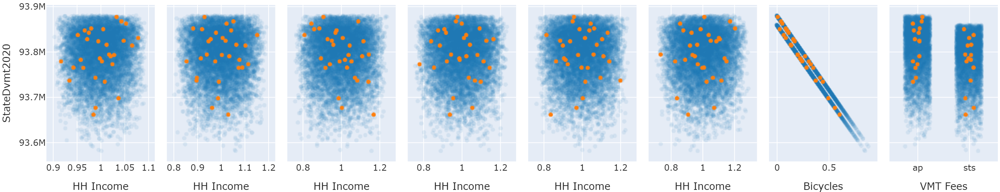

StateDvmt2025

<xmle.Elem 'img' with 0 children>
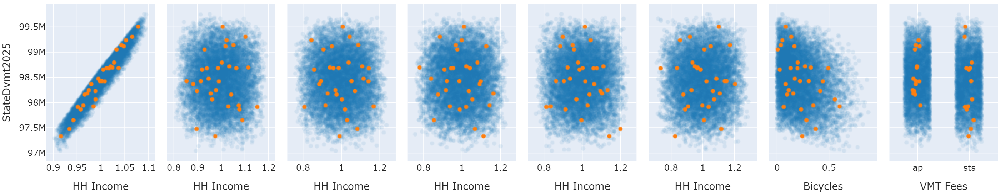

StateDvmt2030

<xmle.Elem 'img' with 0 children>
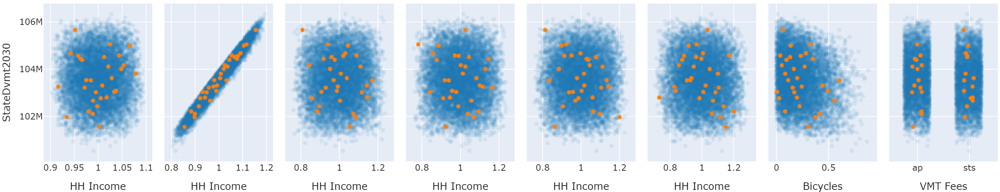

StateDvmt2035

<xmle.Elem 'img' with 0 children>
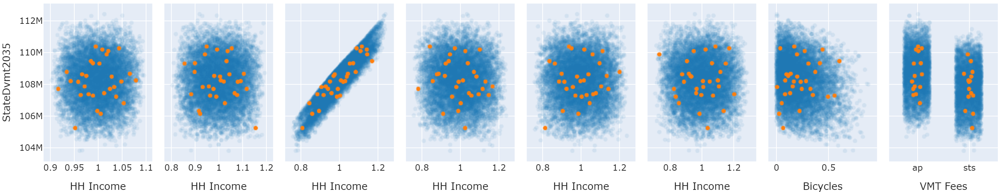

StateDvmt2040

<xmle.Elem 'img' with 0 children>
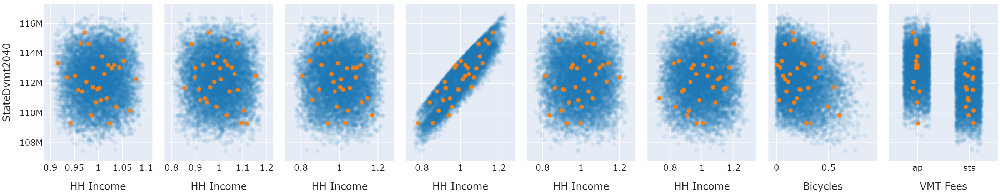

StateDvmt2045

<xmle.Elem 'img' with 0 children>
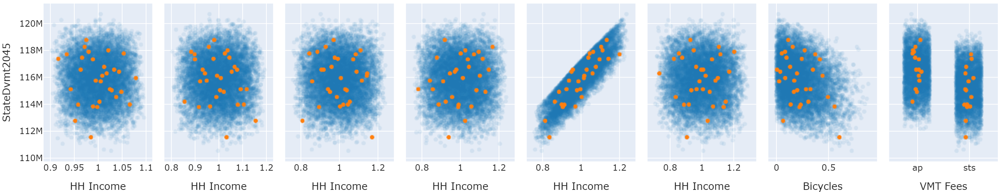

StateDvmt2050

<xmle.Elem 'img' with 0 children>
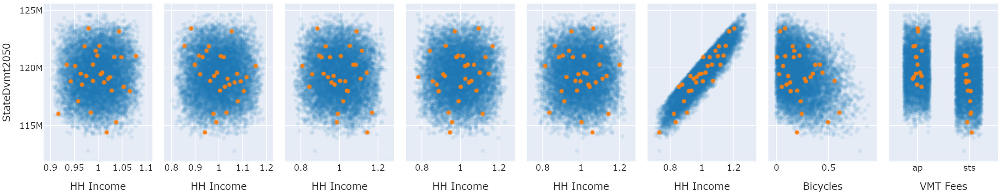

StateHhCarSvcDvmt2020

<xmle.Elem 'img' with 0 children>
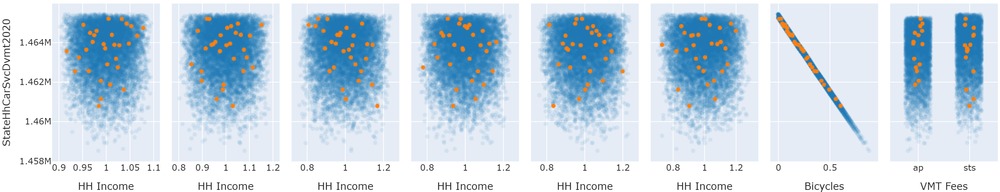

StateHhCarSvcDvmt2025

<xmle.Elem 'img' with 0 children>
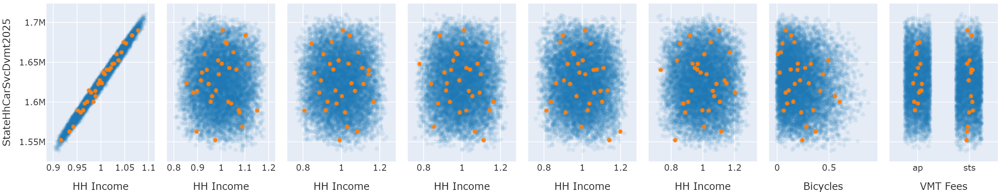

StateHhCarSvcDvmt2030

<xmle.Elem 'img' with 0 children>
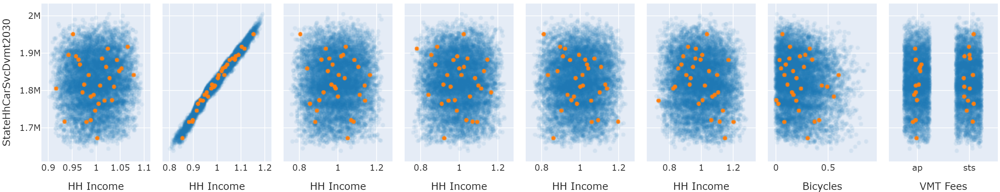

StateHhCarSvcDvmt2035

<xmle.Elem 'img' with 0 children>
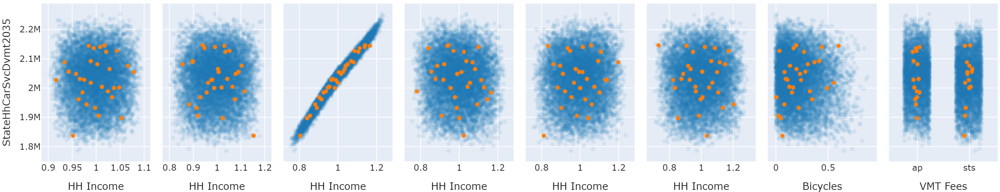

StateHhCarSvcDvmt2040

<xmle.Elem 'img' with 0 children>
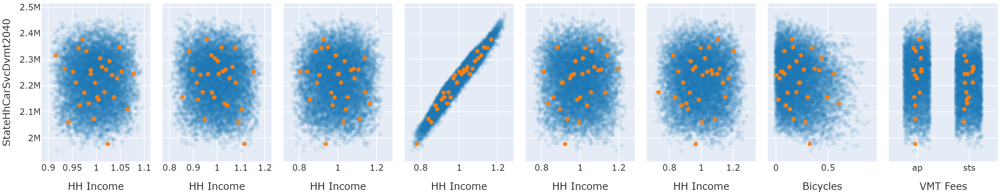

StateHhCarSvcDvmt2045

<xmle.Elem 'img' with 0 children>
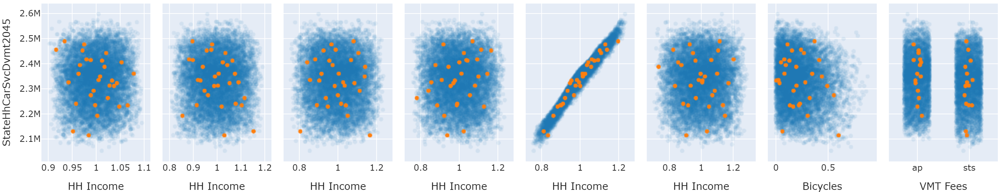

StateHhCarSvcDvmt2050

<xmle.Elem 'img' with 0 children>
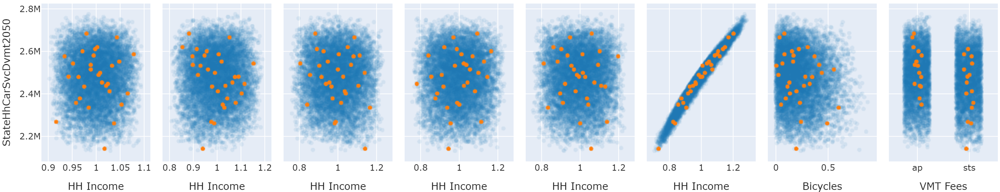

StateTotalDvmt2020

<xmle.Elem 'img' with 0 children>
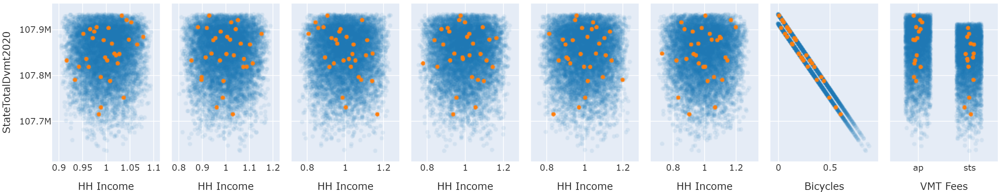

StateTotalDvmt2025

<xmle.Elem 'img' with 0 children>
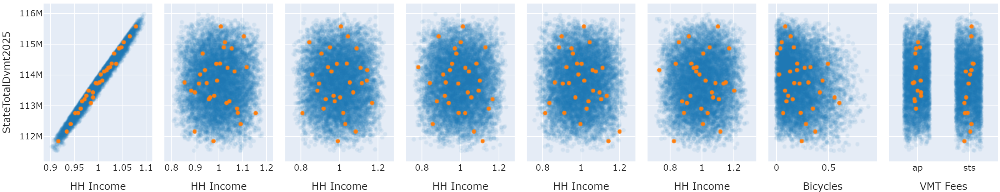

StateTotalDvmt2030

<xmle.Elem 'img' with 0 children>
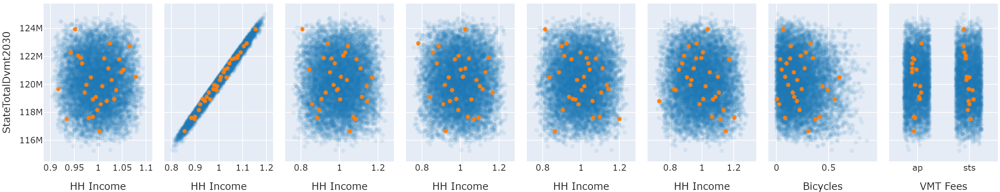

StateTotalDvmt2035

<xmle.Elem 'img' with 0 children>
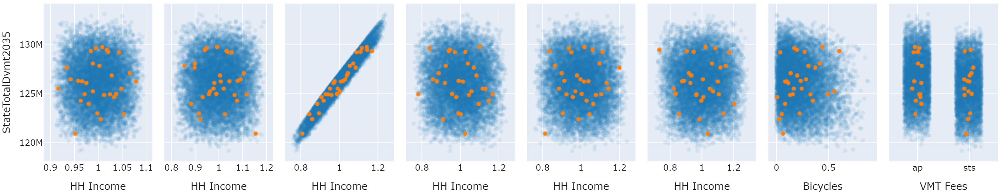

StateTotalDvmt2040

<xmle.Elem 'img' with 0 children>
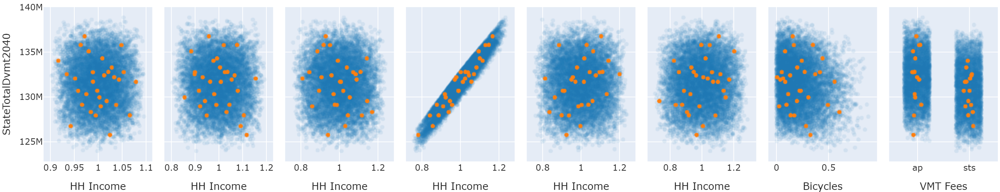

StateTotalDvmt2045

<xmle.Elem 'img' with 0 children>
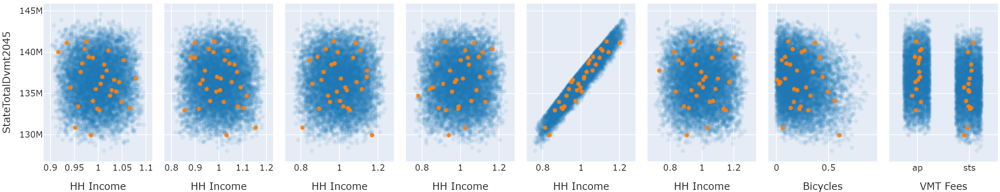

StateTotalDvmt2050

<xmle.Elem 'img' with 0 children>
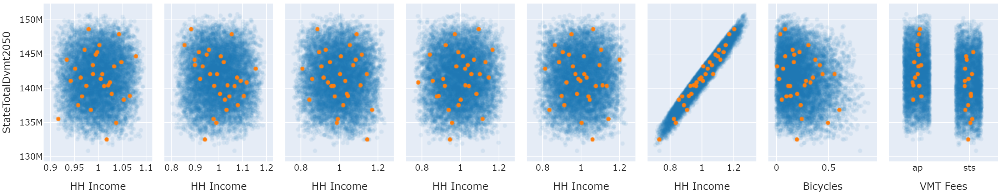

StateTotalGGE2020

<xmle.Elem 'img' with 0 children>
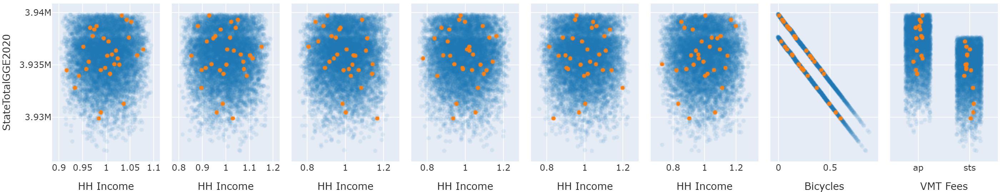

StateTotalGGE2025

<xmle.Elem 'img' with 0 children>
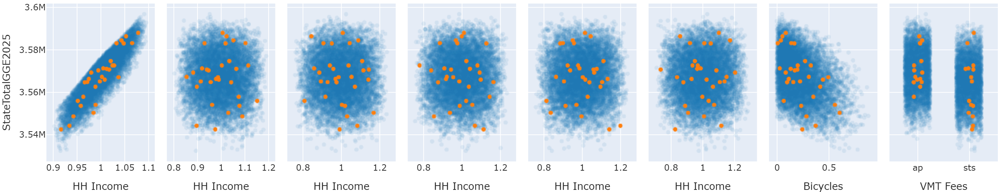

StateTotalGGE2030

<xmle.Elem 'img' with 0 children>
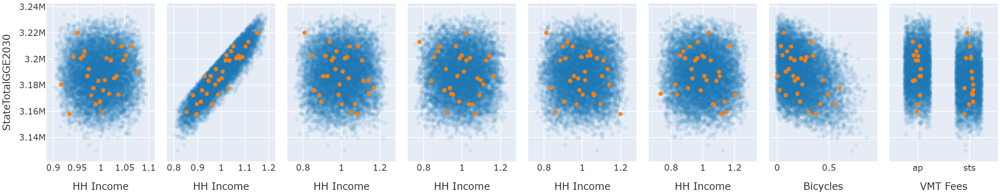

StateTotalGGE2035

<xmle.Elem 'img' with 0 children>
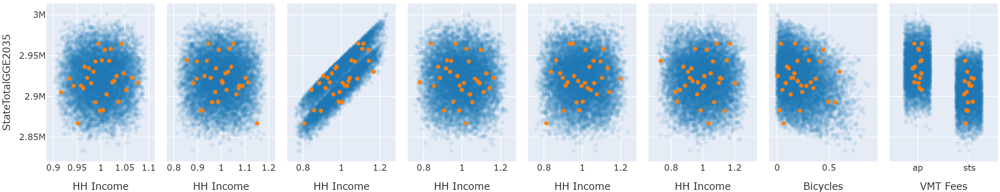

StateTotalGGE2040

<xmle.Elem 'img' with 0 children>
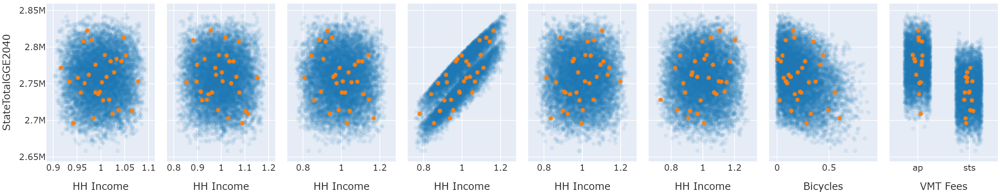

StateTotalGGE2045

<xmle.Elem 'img' with 0 children>
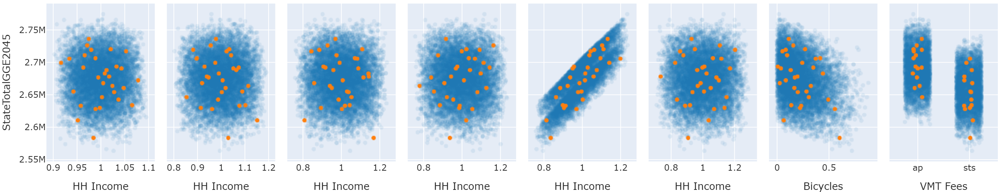

StateTotalGGE2050

<xmle.Elem 'img' with 0 children>
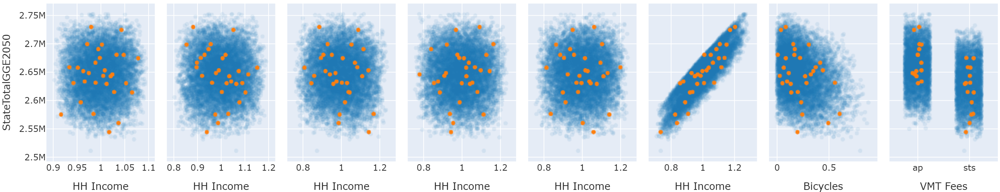

In [24]:
from emat.analysis import contrast_experiments
contrast_experiments(mm.scope, results2, results)

In [ ]:
picked_design = mm.pick_new_experiments(design2, batch_size=60,scope=fx.scope,design_name='pexp60',debug=['Bicycles', 'StateTotalGGE2045'])
picked_design

In [ ]:
mm.regression.estimators[1][1]